# How to Never Forget Deep Q-Networks: Memory Palaces Meet Reinforcement Learning

- The article link about [How to Never Forget Deep Q-Networks: Memory Palaces Meet Reinforcement Learning
](https://guilhermealvessilveira.substack.com/p/how-to-never-forget-deep-q-networks)
- What are we going to learn?
To use the Deep Q-Network algorithm to train an agent, in this case the environment will be [Pong](https://ale.farama.org/environments/pong/).
- Expected result?

![rl-video-episode-0.gif](rl-video-episode-0.gif)

## References
- [Human-level Control Through Deep Reinforcement Learning](https://web.stanford.edu/class/psych209/Readings/MnihEtAlHassibis15NatureControlDeepRL.pdf)
- [Practical AI with Python and Reinforcement Learning](https://www.udemy.com/course/practical-ai-with-python-and-reinforcement-learning)
- [Deep RL Course](https://huggingface.co/learn/deep-rl-course)
- [rainbow-is-all-you-need](https://github.com/Curt-Park/rainbow-is-all-you-need/blob/master/01.dqn.ipynb)
- [all-rl-algorithms](https://github.com/FareedKhan-dev/all-rl-algorithms/blob/master/13_dqn.ipynb)

## Libraries
- [Gymnasium](https://gymnasium.farama.org/)
- [Matplotlib](https://matplotlib.org/)
- [Manim](https://www.manim.community/)
    - To generate the explanation videos
- [ManimML](https://www.manim.community/plugin/manim-ml/)
- [uv](https://docs.astral.sh/uv/)
    - I recommend, as it's very fast to install and manage packages.

## Author of this Notebook

- Guilherme Alves Silveira

The Q-Learning has a limitation of not scaling well to large spaces. If we would solve a problem like chess, we would need a Q-Table with an astronomically large number of entries, since each unique board configuration would represent a distinct state. Another problem is continuous state spaces (for example, 0.1 to 0.93), where one solution is to use binning to discretize values. But imagine that we have millions of states, and for each state, we have to divide the 1.0 into ten parts (for example, [0.1, 0.2], [0.2, 0.3], and so on). In DQN, this problem is solved more elegantly by using a neural network as a function approximator.

## Deep Q-Network for [Pong](https://ale.farama.org/environments/pong/)

You can use [Google Colab in VSCode](https://www.freecodecamp.org/news/how-to-use-google-colab-with-vs-code/), or follow the steps below to run locally in your machine:

Part of the `requirements.txt`:
```
pillow==11.3.0
torch==2.6.0+cu124
torchaudio==2.6.0+cu124
torchvision==0.21.0+cu124
gymnasium[accept-rom-license]==0.28.1 
pygame==2.2.0
ale-py==0.11.2
matplotlib
```

Installation process:
```
pip install uv
uv venv --python 3.12
.venv\Scripts\activate
uv pip install -r requirements.txt --extra-index-url https://download.pytorch.org/whl/cu124 --index-url https://pypi.org/simple
uv pip install gymnasium[atari,accept-rom-license] ale-py
uv run python -c "import torch; print(torch.cuda.is_available())"
```

Execute jupyter notebook: `uv run jupyter lab` or `uv run jupyter notebook`

Make the imports below:

In [3]:
import os
import time
import glob
import torch
import random
import logging
import platform
import numpy as np
import gymnasium as gym
import matplotlib.pyplot as plt
import ale_py

from uuid import uuid4
from typing import NamedTuple, Tuple, Self
from gymnasium import Env
from torch import Tensor, optim, nn
from torch.nn import functional
from tqdm import tqdm

# Register Pong environment
gym.register_envs(ale_py)
logging.basicConfig(level=logging.INFO,  # or logging.DEBUG if you have problems
                    format='%(asctime)s - %(levelname)s - %(message)s')
%matplotlib inline

The method `show_environment` is implemented so that later we can see the rendered environment and the preprocessed state (fed to the model) side by side:

In [4]:
from IPython.display import clear_output, display


def get_visual_array(array, show_last_batch=True):
    # To debug the preprocessing, show in the next steps
    if isinstance(array, Tensor):
        if array.dim() == 4:  # [batch, channels, H, W]
            idx = -1 if show_last_batch else 0
            array = array[idx]
        if array.dim() == 3:  # [channels, H, W] 
            array = array.permute(1, 2, 0)  # [H, W, channels]
        array = array.detach().cpu().numpy()
        return array, "gray"
    elif isinstance(array, np.ndarray):
        if array.ndim == 4:  # [batch, channels, H, W]
            idx = -1 if show_last_batch else 0
            array = array[idx][:,:,-1]
        if array.ndim == 3:  # [channels, H, W] 
            array = array[:,:,-1]  # [H, W, channels]
        return array, "gray"

    return array, None

def imshow(array, cmap, idx_plot):
    ax = plt.subplot(idx_plot)
    ax.axis("off")
    ax.imshow(array, cmap=cmap)

def show_environment(render, preprocessed=None, show_last_batch=True):
    plt.axis("off")
    preprocessed, cmap = get_visual_array(preprocessed)
    if preprocessed is None:
        plt.imshow(render)
    else:
        imshow(render, None, 121)
        imshow(preprocessed, cmap, 122)
    plt.show()
    time.sleep(0.05)

## Just testing random actions to "feel" the environment

### Action Space

Pong uses a **discrete action space** of size 6:

- 0: NOOP  
- 1: FIRE  
- 2: UP
    - In the doc is RIGHT
- 3: DOWN
    - In the doc is LEFT
- 4: RIGHTFIRE  
- 5: LEFTFIRE  

This corresponds to `Discrete(6)`. We will use this discrete action space.

But we'll reduce to only 3:

- 0: NOOP
- 2: UP (RIGHT)
- 3: DOWN (LEFT)

### Observation Space

The default observation returned by `ALE/Pong-v5` is an RGB frame with:

In other words, the observation is a 210x160 RGB image with pixel values in the range `[0, 255]`.  

The visual state contains:

- the right paddle (controlled by the agent)
- the left paddle (controlled by the computer)
- the ball
- the top scoreboard region

### Description

You control the right paddle and compete against an AI-controlled left paddle. Each player attempts to deflect the ball and score points by getting the ball past the opponent’s paddle.

Reference:

[Pong – ALE](https://ale.farama.org/environments/pong/)

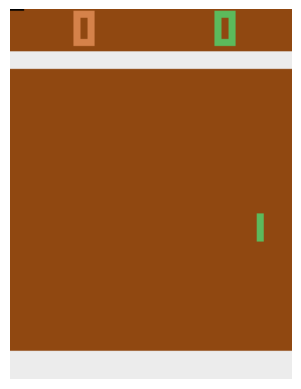

In [6]:
env_name = "PongNoFrameskip-v4"
env = gym.make(env_name, 
               render_mode="rgb_array")
env.reset()

for step in range(50):
    show_environment(env.render())
    action = env.action_space.sample()
    state, reward, term, trunc, info = env.step(action)
    time.sleep(0.001)

    clear_output(wait=True)
    if term or trunc:
        env.reset()
        break

env.close()

![pong1.gif](pong1.gif)

## Manual game execution

Note: If it doesn't work, try running the notebook with python -m notebook or use anaconda

In [4]:
def play():
    """
    Function to get the input and pass to the environment (in this case, you're the agent).
    """
    key = input("Select ws (play) or q (quit):")
    if 'w' == key:
        action = 2  # UP
    elif 's' == key:
        action = 3  # DOWN
    elif 'q' == key:
        print("Leaving the game!")
        raise StopIteration()
    else:
        action = 0  # NOOP

    return action

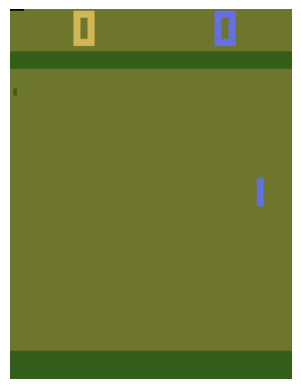

Select ws (play) or q (quit): q


Leaving the game!


In [5]:
env.reset()

try:
    for step in range(30):
        show_environment(env.render())
        action = play()
        _, _, term, trunc, _ = env.step(action)
        clear_output(wait=True)
except StopIteration as stop:
    pass
env.close()

We reduced 6 actions to 3 because the actions are similar, allowing us to train faster:

In [8]:
def map_env_action(action: int) -> int:
    match action:
        case 0 | 1:  # NOOP | FIRE
            return 0
        case 3 | 5:  # DOWN (LEFT | LEFTFIRE)
            return 3
        case 2 | 4:  # UP (RIGHT | RIGHTFIRE)
            return 2
        case _:
            raise ValueError(f"Invalid action: {action}")

def map_model_action(model_action: int) -> int:
    match model_action:
        case 0:
            return 0  # NOOP
        case 1:
            return 3  # DOWN (LEFT)
        case 2:
            return 2  # UP (RIGHT)
        case _:
            raise Exception(f"Invalid model_action: {model_action}")

def map_env2model(action: int) -> int:
    match action:
        case 0:  # NOOP | FIRE
            return 0  # NOOP
        case 3:  # DOWN (LEFT | LEFTFIRE)
            return 1  # DOWN (LEFT)
        case 2:  # UP (RIGHT | RIGHTFIRE)
            return 2  # UP (RIGHT)
        case _:
            raise ValueError(f"Invalid action: {action}")

In [7]:
import time
import functools

from typing import Callable, Any

def timeit(func: Callable) -> Callable:
    @functools.wraps(func)
    def wrapper(*args, **kwargs) -> Any:
        start_time = time.perf_counter()
        result = func(*args, **kwargs)
        end_time = time.perf_counter()
        elapsed_time = end_time - start_time
        
        print(f"{func.__name__}() executed in {elapsed_time:.4f} seconds")
        return result
    
    return wrapper

## Difference between State and Observation on Gymnasium

The `state` is the complete representation of the environment; `observation` is typically partial information about the state. In the Gym library, the two terms are used interchangeably.

In summary, in the code we select `state` to stay similar to the mathematical formula of Deep Q-Network.

The [Spaces](https://gymnasium.farama.org/api/spaces/) type is used by `env.observation_space` and `env.action_space`

In [8]:
state_box = env.observation_space
action_size = env.action_space
state_box, action_size

(Box(0, 255, (210, 160, 3), uint8), Discrete(6))

I've organized each part using objects from the Memory Palace, so, when you reach the end of this article, where we'll encode this knowledge on the virtual space, you'll start to make associations with this code you'll implement through the end. We have five objects that after the end of this implementation, you can try and avoid to use external tools, except for specific details, like PyTorch, but don't worry, mistakes happen (a lot), we just need to practice:

- Drawing Table
- Drawing Compass
- Plumb Line
- Stone
- Stone Shaper

Spoiler:

In [8]:
from IPython.display import Video

Video("memo_palace_dqn.mp4", embed=True, html_attributes="controls loop style='width:100%; height:auto;'")

### Drawing Table

The class PreprocessingWrapper does all four steps, separated by the following methods:

- `_skip_frames`: Responsible for skipping similar frames, so when the network is trained, it's easier to notice the difference between images. If we don't do that, the training will be harder, the same as comparing two similar images. See the example below:

- `_grayscale_frame`: For faster processing, we reduce 3 channels (Red, Green, Blue) to only one (Grayscale), if you have a tensor of `3x210x160` you will have to process `100800` positions, but with only one, you process `33600` positions.

- `_resize_frame`: We reduce the frame to `84x84` to make the process even faster, in this case, we have a reduction of 79%. In this environment we reduce `210x160` to `84x84`. Example:
    - From 210x160 = 33,600 to 84×84 = 7,056
    - Reduction: (33,600 - 7,056) / 33,600 = 79.0%

- `_finish_concatenate_frames`: We concatenate the frames, so our network can learn the movement of the environment, and, based on that, it learns how to react over time. Without it, it would be harder for the network to learn.

- `step`: This function combines all preprocessing steps. In this code, the `term` and `trunc` are joined, but in case you want to make the distinction between them, you can read more in the [Gymnasium documentation](https://gymnasium.farama.org/api/env/#gymnasium.Env.step).

According to the official Gymnasium documentation, `terminated` indicates "whether the agent reaches the terminal state (as defined under the MDP of the task)" while `truncated` indicates "whether the truncation condition outside the scope of the MDP is satisfied."
If you want to learn more about MDP (Markov Decision Process), you can check this [link](https://web.stanford.edu/class/cme241/lecture_slides/david_silver_slides/MDP.pdf).

In [10]:
class PreprocessingWrapper(gym.Wrapper):

    def __init__(self,
                 env: Env,
                 skip=4,
                 resize=84,
                 concatenate=4,
                 interpolation_mode="nearest"):
        super().__init__(env)
        self._skip = skip
        self._resize = resize
        self._concatenate = concatenate
        self._interpolation_mode = interpolation_mode

    def step(self, action: int) -> tuple[Tensor, float, bool, dict]:

        frames = []
        rewards = []

        for _ in range(self._concatenate):
            state, reward, term, trunc, info = self._skip_frames(action)
            gray_state = self._grayscale_frame(state)
            resized_state = self._resize_frame(gray_state)
            frames.append(resized_state)
            rewards.append(reward)

            if term or trunc:
                break

        concat_state, total_reward = self._finish_concatenate_frames(frames, rewards)
        return concat_state, total_reward, term, trunc, info

    def _skip_frames(self, action: int):
        # Hopscotch - Get meaningful changes between images
        total_reward = 0
        for _ in range(self._skip + 1):
            state, reward, term, trunc, info = self.env.step(action)
            total_reward += reward
            if term or trunc:
                break

        return state, total_reward, term, trunc, info

    def _grayscale_frame(self, state):
        # We first convert to PyTorch
        state = torch.from_numpy(state).float()
        # Greyscale fish - Make processing faster. We have [Height, Width, Channel], we apply the mean in the Channel
        state = (state.mean(dim=2, keepdim=True)
                      .permute(2, 0, 1)
                      .to(dtype=torch.uint8))
        return state

    def _resize_frame(self, state):
        # Binoculos of Fire 84x84 (major method mnemonic) - We optimize processing to work with a smaller images
        return (functional.interpolate(state.unsqueeze(dim=0),
                                       size=(self._resize, self._resize),
                                       mode=self._interpolation_mode)).squeeze(dim=0)

    def _finish_concatenate_frames(self, frames, rewards):
        # We ensure that the shape is 4x84x84 in the end
        for i in range(len(frames), self._concatenate):
            last_state = frames[-1]
            last_reward = rewards[-1]
            # We clone to maintain consistency
            frames.append(last_state.clone())
            rewards.append(last_reward)
        # Cat grabs the ears (4) frames - With this, the neural network can learn the moviment in the image
        state = torch.cat(frames, dim=0)
        total_reward = sum(rewards)
        return state, total_reward

    def reset(self, *, seed=None, options=None) -> Tuple[Tensor, dict]:
        state, info = self.env.reset(seed=seed, options=options)

        frames = []
        rewards = []

        gray_state = self._grayscale_frame(state)
        resized_state = self._resize_frame(gray_state)

        frames.append(resized_state)
        rewards.append(0.0)

        concat_state, _ = self._finish_concatenate_frames(frames, rewards)
        return concat_state, info

Below the explanation in video about the preprocessing steps:

In [11]:
from IPython.display import Video
# Code made with the help of claude.ai
Video("preprocess_pong.mp4", embed=True, html_attributes="controls loop style='width:100%; height:auto;'")

If you're in doubt about `_finish_concatenate`, execute the code below and make your tests
with `frames = [0]`, or `frames = [0, 1]`, so on:

In [12]:
frames = [0, 1]
concat = 4
for i in range(len(frames), concat):
    frames.append(i)
frames

[0, 1, 2, 3]

#### Check if CUDA is available, if you have AMD, you can try ROCm

In [13]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"CUDA? {device}")

CUDA? cuda


In [ ]:
def make_wrapped_env(env_name, device, **params):
    render_node = params.get("render_mode", "rgb_array")
    env = gym.make(env_name, 
                   render_mode=render_node,
                   **params)
    env.reset()
    env = PreprocessingWrapper(env)
    return env

env_name = "PongNoFrameskip-v4"
env = make_wrapped_env(env_name, device)

# The states will be used in the example below, to explain the argmax and max
states = []

for step in range(50):
    action = env.action_space.sample()
    state, reward, term, trunc, info = env.step(action)
    show_environment(env.render(), state)
    states.append(state)
    if term or trunc:
        env.reset()
        break
    time.sleep(0.05)
    clear_output(wait=True)

env.close()

![pong3.gif](pong3.gif)

<i>Note about development process</i>: The method `debug_concat_frames` was created because the agent was not learning, the cause was because the class `PreprocessingWrapper` had an error on the conversion type, we had a normalized image in the range `[0, 1]` but, when we passed to the `ReplayBuffer`, the states was all zeroed, because the states were being stored as uint8, so we lost the values in-between 0 and 1. The `debug_concat_frames` helped to debug and find this problem.

In [ ]:
def debug_concat_frames(tensor: Tensor):
    tensor = tensor.detach().cpu()
    fig, axes = plt.subplots(1, 4, figsize=(12, 12))

    for i, ax in enumerate(axes.flat):
        frame = tensor[i]  # shape (84, 84)
        ax.imshow(frame, cmap='gray')
        ax.set_title(f"Frame {i}")
        ax.axis('off')

    plt.tight_layout()
    plt.show()

debug_concat_frames(states[5])

Below, you can see the difference between frames, you can increase the `skip` parameter of the environment Pong to see this difference increase more, but I do not recommend training with `skip` greater than 4, it make hard to predict the flow of the ball and the paddle.

![pong_debug_frames.jpg](pong_debug_frames.jpg)

### Drawing Compass

We are going to define the architecture of our neural network, but let's have a simple explanation of CNN and its advantages:

A CNN is a type of neural network architecture that uses convolutional filters that slide across the spatial dimensions of the image (such as RGB channels), and produces feature maps. 

These feature maps maintain spatial information of the original image, after that we apply some pooling operations, like average or max, to reduce the data size and keep the most important information, and at the end of the network, after passing through multiple convolutional layers, backpropagation computes the filter weights during training, and the optimizer updates the weights, allowing each filter to learn specific information. For example: 

1. First layers detect information about lines, angles, edges, gradients, colors and simple textures.
2. Intermediate layers detect information about parts of objects such as eyes, mouths, noses and wheels. 
3. Deeper layers detect complex details about faces, hands, bodies, objects, or cars.

CNNs learn hierarchical features: the first layers learn local patterns, and the last layers learn global patterns.
Observation: Pooling layers usually don’t have weights in them, so they are not updated in backpropagation.
The pattern \[B, C, H, W\] is the same as \[Batch, Channels, Height, Width\]. And when we call the `unsqueeze()` we are adding in the specified position, a new dimension, so we go from \[C, H, W\] to \[1, C, H, W\] if you make `unsqueeze(0)`, but if you make `unsqueeze(1)`, it would be from \[C, H, W\] to \[C, 1, H, W\].

![cnn_diagram.jpg](cnn_diagram.jpg)

In case you want to study later about the subject, see the sources below:

- [CNN Explainer](https://poloclub.github.io/cnn-explainer/)
- [Convolutional Neural Network: A Complete Guide](https://learnopencv.com/understanding-convolutional-neural-networks-cnn/)
- [Feature Visualization](https://distill.pub/2017/feature-visualization/)
- [Convolutional Neural Networks (CNN Visualized)](https://www.youtube.com/watch?v=pj9-rr1wDhM)
- [Neural Networks Part 8: Image Classification with Convolutional Neural Networks (CNNs)](https://www.youtube.com/watch?v=HGwBXDKFk9I)

<i>Note about development process</i>: Our specific implementation doesn't use pooling layers and the last layer is **raw Q-values**, be careful to not put an activation layer of sigmoid, softmax, etc.

In case you want to understand how the convolution works, watch the video below:

Note: The architecture show in the video, is not the same as implemented, it's just for reference.

In [15]:
from IPython.display import Video
# Code made with the help of claude.ai
Video("cnn_example_arch.mp4", embed=True, html_attributes="controls loop style='width:100%; height:auto;'")

For the network we'll base our implementation described in the paper, with difference that the input is 4x84x84 instead of 84x84x4:

“The exact architecture, shown schematically in Fig. 1, is as follows. The input to the neural network consists of an 84 × 84 × 4 image produced by the preprocessing map ϕ. The first hidden layer convolves 32 filters of 8 × 8 with stride 4 with the input image and applies a rectifier nonlinearity. The second hidden layer convolves 64 filters of 4 × 4 with stride 2, again followed by a rectifier nonlinearity. This is followed by a third convolutional layer that convolves 64 filters of 3 × 3 with stride 1 followed by a rectifier. The final hidden layer is fully-connected and consists of 512 rectifier units. The output layer is a fully-connected linear layer with a single output for each valid action. The number of valid actions varied between 4 and 18 on the games we considered.”

— Mnih et al., Human-level Control Through Deep Reinforcement Learning, Nature, 2015.

Note: The old architecture was basically `(channels=128, kernel=7)` -> `(channels=64, kernel=5)` -> `(channels=32, kernel=3)` without stride, however the model was complex and was not converging, so I decided to use the architecture of the paper. Other point is that, when we usually train object detection and classification we start with a bunch of `channels` and we reduce along the way, but the DQN does the opposit.

In [22]:
class Network(nn.Module):

    def __init__(self, input_size: int, actions: int):
        # https://docs.pytorch.org/docs/stable/generated/torch.nn.Module.html
        super(Network, self).__init__()
        self.conv1 = nn.Conv2d(in_channels=input_size, out_channels=32, stride=4, kernel_size=(8, 8))
        self.relu1 = nn.ReLU()
        self.conv2 = nn.Conv2d(in_channels=32, out_channels=64, stride=2, kernel_size=(4, 4))
        self.relu2 = nn.ReLU()
        self.conv3 = nn.Conv2d(in_channels=64, out_channels=64, stride=1, kernel_size=(3, 3))
        self.relu3 = nn.ReLU()
        self.flatten = nn.Flatten()
        # LazyLinear calculates the size of linear layer for us
        self.linear1 = nn.LazyLinear(out_features=512)
        self.relu4 = nn.ReLU()
        self.linear2 = nn.LazyLinear(actions)

    def forward(self, x):
        x = self.relu1(self.conv1(x))
        x = self.relu2(self.conv2(x))
        x = self.relu3(self.conv3(x))
        x = self.flatten(x)
        x = self.relu4(self.linear1(x))
        x = self.linear2(x)
        return x

In the `torch.cat()` part, we put an extra dimension so we concatenate in this dimension, 
where we go from 4x84x84 to **1**x4x84x84, then join the images on first dimension to make from **1**x4x84x84 to **2**x4x84x84, and so
on, until we concatenate all of them, becoming **50**x4x84x84.
After that, we create the network just to test, and get 6 random states so the explanation can be easier (can be more, or less, I choose 6).

**Note about development process**: Pong’s action space contains 6 discrete actions. However, in the example below, I will use only 5 actions to simplify the demonstration.

In [23]:
action_space_test_n = 5
states = torch.cat([state.unsqueeze(0) for state in states], dim=0)
print("states shape:", states.shape)

test_model = Network(input_size=4, actions=action_space_test_n)
six_states = states[torch.randint(low=0, high=len(states), size=(6,))]
print("shape:", six_states.shape)
# We need to convert to float, because the neural network don't accept ints
print("uint8 type:", six_states.dtype)
six_states = six_states.float().div_(255.0)
print("float32 type:", six_states.dtype)

states shape: torch.Size([50, 4, 84, 84])
shape: torch.Size([6, 4, 84, 84])
uint8 type: torch.uint8
float32 type: torch.float32


We'll learn how to use the dim (dimension) parameter in PyTorch, similiar to other libraries such as NumPy.
When we call these functions without passing the **dim** parameter:

- **max()**:  returns the single greatest element of the tensor (a scalar value).
- **argmax()**: returns the index of the greatest element.

The **max()** function is below as an example:

![tensor_max.jpg](tensor_max.jpg)

In [24]:
print(test_model.forward(six_states))
print(test_model.forward(six_states).argmax())
print(test_model.forward(six_states).max())

tensor([[ 0.0025, -0.0352, -0.0022,  0.0048, -0.0281],
        [ 0.0026, -0.0353, -0.0022,  0.0044, -0.0284],
        [ 0.0030, -0.0355, -0.0023,  0.0050, -0.0284],
        [ 0.0024, -0.0352, -0.0025,  0.0046, -0.0282],
        [ 0.0027, -0.0359, -0.0019,  0.0047, -0.0284],
        [ 0.0028, -0.0354, -0.0023,  0.0047, -0.0285]],
       grad_fn=<AddmmBackward0>)
tensor(13)
tensor(0.0050, grad_fn=<MaxBackward1>)


When we use `dim=0`, `argmax()` or `max()` is applied column-wise, reducing the tensor by comparing elements across rows, as shown in the example below.

![tensor_max_dim_0.jpg](tensor_max_dim_0.jpg)

In [25]:
print(test_model(six_states).argmax(dim=0))
print(test_model(six_states).max(dim=0))

tensor([2, 3, 4, 2, 0])
torch.return_types.max(
values=tensor([ 0.0030, -0.0352, -0.0019,  0.0050, -0.0281], grad_fn=<MaxBackward0>),
indices=tensor([2, 3, 4, 2, 0]))


When we use `dim=1`, `argmax()` or `max()` is applied row-wise, reducing the tensor by comparing elements across columns, as shown in the example below.

![tensor_max_dim_1.jpg](tensor_max_dim_1.jpg)

We use `dim=1` because we want the maximum action value for each `state`. The tensor shape is `[batch_size, actions]`.

In [20]:
print(test_model.forward(six_states).argmax(dim=1))
print(test_model.forward(six_states).max(dim=1))
# Reshaped to be vertical, just to create the example above
print(test_model.forward(six_states).max(dim=1).values.reshape(-1, 1))

tensor([1, 1, 1, 1, 1, 1])
torch.return_types.max(
values=tensor([0.0288, 0.0288, 0.0289, 0.0285, 0.0292, 0.0289],
       grad_fn=<MaxBackward0>),
indices=tensor([1, 1, 1, 1, 1, 1]))
tensor([[0.0288],
        [0.0288],
        [0.0289],
        [0.0285],
        [0.0292],
        [0.0289]], grad_fn=<ViewBackward0>)


We will learn how `torch.gather` works, as it will be used later in this article. In the example below, `actions` has shape `(6,)`, but the `q_values` has shape `(6, 5)`, to use `torch.gather` (the same as `test_model(six_states).gather(...)`) we must reshape `actions` shape to the dimensions as `q_values`, we use `actions.unsqueeze(1)` to do that.
Why `torch.gather`? It's useful for sparse data handling, where we don't work with fixed positions, like Reinforcement Learning situations, or even Recommendation Systems, like the [Factorization Machines](https://www.d2l.ai/chapter_recommender-systems/fm.html), where data is extremely sparse.

![tensor_unsqueeze_and_gather_2.jpg](tensor_unsqueeze_and_gather_2.jpg)

Source:

- https://stackoverflow.com/questions/50999977/what-does-gather-do-in-pytorch-in-layman-terms
    - This one has excellent explanations. I recommend checking it out.
- https://docs.pytorch.org/docs/stable/generated/torch.gather.html#torch.gather

In [21]:
actions = torch.tensor([0, 1, 2, 3, 4, 1])
q_values = test_model(six_states)
print("actions shape [before unsqueeze]:", actions.shape)
actions = actions.unsqueeze(1)
print("actions shape [after unsqueeze]:", actions.shape)
print("model output shape:", q_values.shape)
print("actions:\n", actions)
print("test_model output:\n", test_model(six_states))
print(test_model(six_states).gather(dim=1, index=actions))

actions shape [before unsqueeze]: torch.Size([6])
actions shape [after unsqueeze]: torch.Size([6, 1])
model output shape: torch.Size([6, 5])
actions:
 tensor([[0],
        [1],
        [2],
        [3],
        [4],
        [1]])
test_model output:
 tensor([[-0.0145,  0.0288, -0.0493, -0.0139,  0.0201],
        [-0.0146,  0.0288, -0.0491, -0.0139,  0.0207],
        [-0.0145,  0.0289, -0.0492, -0.0138,  0.0203],
        [-0.0148,  0.0285, -0.0492, -0.0142,  0.0202],
        [-0.0148,  0.0292, -0.0487, -0.0140,  0.0203],
        [-0.0145,  0.0289, -0.0489, -0.0141,  0.0201]],
       grad_fn=<AddmmBackward0>)
tensor([[-0.0145],
        [ 0.0288],
        [-0.0492],
        [-0.0142],
        [ 0.0203],
        [ 0.0289]], grad_fn=<GatherBackward0>)


In [22]:
del test_model
size = 1_000
state_shape = state.shape
torch.zeros((size,) + state_shape).shape

torch.Size([1000, 4, 84, 84])

### 

In the AgentDQN constructor, we configure two networks, one is the Q-online network that'll be trained in real time, while Q-target will have weights that are updated periodically and won't be trained directly. Q-target will be used as a baseline so the training can be more stable, different from supervised learning, where we already have the labels, in reinforcement learning we must learn about the environment in real time, so the authors of the paper [Human-level Control Through Deep Reinforcement Learning](https://web.stanford.edu/class/psych209/Readings/MnihEtAlHassibis15NatureControlDeepRL.pdf), proposed these two networks as a solution. Imagine we have just one network, the training will be very unstable, making it harder to converge to the optimal solution.

The method `select_action`, is almost the same as the traditional Q-Learning based on Q-Table algorithm, in the previous article we used epsilon-greedy, and this follows the same approach, with the difference that we use a neural network.
- Note: In `select_action` we use `@torch.no_grad()` because we don't need a computational graph for backpropagation, since we're only getting actions and not training. We'll train our Q-online network using the DQN formula (the explanation is in the "Stone" part).

For the optimizer, we'll use `RMSprop`, the same used in the paper on which we based this implementation. 
Below is an example of how typically they behave, where `RMSProp` tends to be more stable than standard `SGD`:
![sgd_vs_rmsprop.jpg](sgd_vs_rmsprop.jpg)
<small>Generated by Google Gemini</small>

If you want to learn more about how `RMSprop` and `SGD` work, you can check the links below:

- [RMSProp (C2W2L07)](https://www.youtube.com/watch?v=_e-LFe_igno)
- [RMSProp d2l](https://d2l.ai/chapter_optimization/rmsprop.html)
- [PyTorch RMSprop](https://docs.pytorch.org/docs/stable/generated/torch.optim.RMSprop.html)
- [Exponentially Weighted Moving Average (EWMA) Explained | Deep Learning #10](https://www.youtube.com/watch?v=dlajqZn7bjM)
- [Stochastic Gradient Descent](https://en.wikipedia.org/wiki/Stochastic_gradient_descent)
- [Backpropagation, intuitively | Deep Learning Chapter 3](https://www.youtube.com/watch?v=Ilg3gGewQ5U)

The `_get_fig_axes()`, `_draw_progress()`, `_checkpoint()` and `from_checkpoint()` will not be mentioned in the memory palace part, but they'll be used to draw graphics, showing the evolution of this agent, over time. We can go back to checkpoints too.

The other methods that we'll bind later, are going to be explained subsequently step by step.

In [23]:
# We'll bind the empty methods later

class AgentDQN:

    def __init__(self,
                 device: torch.device,
                 episodes: int,
                 epsilon_min: float,
                 epsilon_decay: float,
                 gamma: float,
                 update_interval: int,
                 checkpoint_min_episodes: int,
                 action_space_n: int,
                 learning_rate: float = 0.00025,
                 cat_input_size: int = 4,
                 inference: bool = False,
                 interactive: bool = True,
                 execution_id: str = None,
                 map_env_action=lambda action: action,
                 map_model_action=lambda model_action: model_action,
                 _loading_checkpoint: bool = False):
        self.execution_id = uuid4().hex if execution_id is None else execution_id
        self.device = device
        self.episodes = episodes
        self.epsilon_min = epsilon_min
        self.epsilon_decay = epsilon_decay
        self.gamma = gamma
        self.update_interval = update_interval
        self.checkpoint_min_episodes = checkpoint_min_episodes
        self.inference = inference
        self.interactive = interactive
        self.map_env_action = map_env_action
        self.map_model_action = map_model_action
        self.cnt_frames = 0
        self.logger = logging.getLogger(self.__class__.__name__)

        if not _loading_checkpoint:
            q_online = Network(input_size=cat_input_size, 
                               actions=action_space_n)
            q_target = Network(input_size=cat_input_size, 
                               actions=action_space_n)
            q_target.load_state_dict(q_online.state_dict())
            self._set_mode(q_online)
            self._set_mode(q_target, freeze=True)
            self.q_online = q_online.to(device)
            self.q_target = q_target.to(device)
            self.optimizer = optim.RMSprop(q_online.parameters(), 
                                           lr=learning_rate)
            os.makedirs(f"./checkpoints_{self.execution_id}", exist_ok=True)
            self.logger.info(f"Created the agent: {self.execution_id}")
        else:
            self.q_online = None
            self.q_target = None
            self.optimizer = None
            self.logger.info(f"Loading checkpoint...")

    @torch.no_grad()
    def select_action(self, env: Env, epsilon: float, state: Tensor):
        # Mr. Krabs, remember? epsilon-greedy
        if torch.rand(1).item() < epsilon:
            return self.map_env_action(env.action_space.sample())

        # [C, H, W] -> [1, C, H, W]
        state = (state.to(self.device, dtype=torch.float32)
                      .div_(255.)
                      .unsqueeze_(dim=0))
        action = self.q_online(state).argmax(dim=1)
        return self.map_model_action(action.item())

    def _get_fig_axes(self, plot_trackers_count: int) -> Tuple[plt.Figure, list[plt.Axes]]:
        fig = plt.figure(figsize=(6 * plot_trackers_count, 5))
        axs = fig.subplots(nrows=1, 
                           ncols=plot_trackers_count)

        if not isinstance(axs, (list, tuple, np.ndarray)):
            axs = [axs]

        if self.interactive:
            plt.ion()
            plt.show(block=False)

        return fig, axs

    def _draw_progress(self,
                       pbar: tqdm,
                       fig: plt.Figure,
                       axs: list[plt.Axes],
                       episode: int, 
                       log_interval: int, 
                       cnt_frames: int,
                       episode_tracker: list[int],
                       plot_trackers: dict[str, list]) -> None:
        if episode == 0:
            return

        pbar.set_postfix({
            "ε": f"{plot_trackers['epsilon'][-1]:.4f}",
            "🪙": f"{plot_trackers['reward'][-1]:.4f}",
            "📉": f"{plot_trackers['loss'][-1]:.4f}",
            "🖼️": str(cnt_frames)
        })

        if (episode % log_interval == 0 or
            episode == self.episodes):
            reward = int(plot_trackers["reward"][-1])
            self.logger.info(f"Rewards: {reward}, count frames: {cnt_frames}")

            for ax, (title, tracker) in zip(axs, plot_trackers.items()):
                ax.clear()
                ax.set_title(title)
                ax.plot(episode_tracker, tracker)
            plt.tight_layout()
            fig.canvas.draw_idle()
            if not self.interactive:
                display(fig)

    def _set_mode(self, model: Network, freeze: bool = False) -> None:
        if freeze or self.inference:
            # Don't compute statistics
            model.eval()
            # Don't compute gradients
            for param in model.parameters():
                param.requires_grad = False
        else:
            # Generate statistics used in training
            model.train()

    def _checkpoint(self,
                    episode: int,
                    current_total_reward: float,
                    best_total_reward: float,
                    cnt_frames: int,
                    trackers: dict,
                    delta: float = 0.0001) -> float:
        # delta is used to avoid the problem with float numbers
        if (episode <= 0 or
            current_total_reward < (best_total_reward + delta) or
            episode < self.checkpoint_min_episodes):
            return best_total_reward

        self.logger.info(f"Creating checkpoint because current_total_reward > best_total_reward: "
                         f"{current_total_reward} > {best_total_reward}")
        self.save_training(episode,
                           current_total_reward,
                           cnt_frames,
                           f"checkpoint_{str(episode).replace(".", "_")}_{current_total_reward}",
                           trackers)
        return current_total_reward

    def save_training(self,
                      episode: int,
                      reward: float,
                      cnt_frames: int,
                      file_name: str,
                      trackers: dict = None) -> None:

        if not trackers:
            trackers = {
                "epsilon": [np.nan],
                "reward": [reward],
                "loss": [np.nan],
            }

        # I'll save together, but the standard way is to save the metadata separated from the weights
        checkpoint_info = {
            "episode": episode,
            "cnt_frames": cnt_frames,
            "epsilon_min": self.epsilon_min,
            "epsilon_decay": self.epsilon_decay,
            "gamma": self.gamma,
            "update_interval": self.update_interval,
            "checkpoint_min_episodes": self.checkpoint_min_episodes,
            "learning_rate": self.optimizer.param_groups[0]['lr'],
            "model_state_dict": self.q_online.state_dict(),
            "optimizer_state_dict": self.optimizer.state_dict(),
            "epsilon": trackers["epsilon"][-1],
            "reward": trackers["reward"][-1],
            "loss": trackers["loss"][-1],
        }

        torch.save(checkpoint_info, f"./checkpoints_{self.execution_id}/{file_name}.pth")

    @classmethod
    def from_checkpoint(cls, 
                        execution_id: str, 
                        episode: int,
                        episodes: int,
                        action_space_n: int,
                        file_path: str,
                        cat_input_size: int = 4,
                        inference: bool = False,
                        interactive: bool = False,
                        map_env_action=lambda action: action) -> Self:
        logging.getLogger(cls.__name__).debug(f"Getting agent from checkpoint: {file_path}")
        if not os.path.exists(file_path):
            raise FileNotFoundError(f"No checkpoint file \"{file_path}\" found for execution_id: {execution_id}")

        checkpoint_info = torch.load(file_path,
                                     weights_only=False,
                                     map_location="cpu")
        device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        model_state_dict = checkpoint_info["model_state_dict"]

        agent = cls(
            device=device,
            episodes=episodes,
            epsilon_min=checkpoint_info["epsilon_min"],
            epsilon_decay=checkpoint_info["epsilon_decay"],
            gamma=checkpoint_info["gamma"],
            update_interval=checkpoint_info["update_interval"],
            checkpoint_min_episodes=checkpoint_info["checkpoint_min_episodes"],
            action_space_n=action_space_n,
            cat_input_size=cat_input_size,
            inference=inference,
            interactive=interactive,
            execution_id=execution_id,
            map_env_action=map_env_action,
            _loading_checkpoint=True
        )

        q_online = Network(input_size=cat_input_size,
                           actions=action_space_n)
        q_target = Network(input_size=cat_input_size,
                           actions=action_space_n)
        q_online.load_state_dict(checkpoint_info["model_state_dict"])
        q_target.load_state_dict(checkpoint_info["model_state_dict"])

        agent._set_mode(q_online, freeze=inference)
        agent._set_mode(q_target, freeze=True)

        agent.q_online = q_online.to(device)
        agent.q_target = q_target.to(device)

        agent.optimizer = optim.RMSprop(agent.q_online.parameters(),
                                        lr=checkpoint_info["learning_rate"])
        agent.optimizer.load_state_dict(checkpoint_info["optimizer_state_dict"])

        agent.logger.info(f"Loaded agent from checkpoint: {file_path}")
        agent.logger.info(f"Checkpoint episode: {checkpoint_info["episode"]}")
        agent.logger.info(f"Checkpoint epsilon: {checkpoint_info["epsilon"]:.4f}")
        agent.logger.info(f"Checkpoint reward: {checkpoint_info["reward"]:.4f}")
        agent.logger.info(f"Checkpoint loss: {checkpoint_info["loss"]:.4f}")

        return agent

    # bind later
    def train(self,
              env: Env,
              epsilon: float,
              log_interval: int,
              replay_buffer: "ReplayBuffer",
              loss_func: "_Loss",
              start_episode: int = 0) -> None:
        pass

    # bind later (1)
    def run(self,
            env: Env,
            episodes: int = 10,
            output: bool = True,
            epsilon: float = 0.01,
            video_folder: str = None) -> list[float]:
        pass

    # bind later (2)
    def _train_q_online(self,
                        replay_buffer: "ReplayBuffer",
                        loss_func: "_Loss") -> float:
        pass

    # bind later (3)
    def _update_q_target(self, episode: int) -> None:
        pass

    # bind later (4)
    def _reduce_epsilon(self, epsilon: float) -> float:
        pass


### Plumb Line

The replay buffer will be used as a store for past experiences, so when we train, we uniformly sample from it. You can read the mathematical notation as "Make a uniform distribution sampling on `D`, where `D` is the representation of the replay buffer in the article we are basing this implementation (we include the `d` of done, but in the original article, it's omitted):

$\begin{flalign}
(s, a, r, s_{t+1}, d) \sim U(\mathcal{D}) \\
s = \text{states} \\
r = \text{rewards} \\
a = \text{actions} \\
s_{t+1} = \text{next states} \\
d = \text{done} \\
\sim \text{ } = \text{sampled from or distributed as} \\
U = \text{uniform}
\end{flalign}$

Why do we use `torch.zeros(...)` in the `ReplayBuffer` instead of `collections.deque`? Because it's a block-linked array (resembles a linked list, but uses blocks instead of nodes) data structure, so, you'll have `O(n)` to access elements in the middle for example. It'll be slow when sampling multiple random experiences, `deque` has `O(1)` access only at the head and tail. Other extra advantages:

- Contiguous memory allocation
- O(1) random access via indexing
- GPU compatibility (can transfer to CUDA)
- Better cache locality

In the `sample_batch` we use `np.random.choice` because `torch.randint` does not have an option to work without replacement (with replacement, we can repeat the same samples), and the variable `self.count` is used instead of `self.size` because we want to sample in valid positions, the other positions in the beginning were not filled with valid states, they're zeroed data, that `torch` allocated for us.

**More about optimization**

Another optimization we made was to store the states as uint8, because at first, I used float32, but it occupies too much memory. It's sufficient to store as uint8 because it holds 256 possible values (0-255), which is good for images. One image as uint8 is 28,224 bytes while float32 is 112,896 bytes. However, this introduces another problem: PyTorch (and neural networks in general) works with float values. The solution is to convert to float32 when a sample is drawn from the buffer, and then pass it to the device (CUDA if you have a GPU). Later I decided to optimize the other fields as well, except for the `reward`, because if we use float16 or uint8, we'll lose precision and when training, the gradients can vanish.

**Details of PyTorch**

Methods that end with an <u>underscore</u> (like `.div_()`, `.add_()`) modify the tensor in place, so they're mutable operations, while methods without underscores return new tensors. We use `.div_(255.0)` to make execution faster and avoid unnecessary copies. Since `tensor.to()` already creates a new tensor, the in-place division doesn't affect the original `states` and `next_states` stored in the buffer.

Sources:

- https://github.com/Curt-Park/rainbow-is-all-you-need/blob/master/01.dqn.ipynb
- https://stackoverflow.com/questions/6256983/how-are-deques-in-python-implemented-and-when-are-they-worse-than-lists
- https://github.com/python/cpython/blob/v3.8.1/Modules/_collectionsmodule.c
- https://docs.pytorch.org/docs/stable/generated/torch.Tensor.to.html

In [24]:
class Experience(NamedTuple):
    state: torch.ByteTensor  # uint8
    action: torch.ByteTensor  # uint8
    reward: torch.FloatTensor
    next_state: torch.ByteTensor  # uint8
    done: torch.BoolTensor


class ReplayBuffer:

    def __init__(self, 
                 size: int, 
                 state_shape: torch.Size, 
                 batch_size: int, 
                 device: torch.device,
                 map_env2model: lambda action: action,
                 _load_from_file=False):
        if _load_from_file:
            logging.info("Loading ReplayBuffer from file")
            return

        self.size = size
        self.batch_size = batch_size
        self.pos = 0
        self.count = 0
        self.device = device
        self.map_env2model = map_env2model
        # states and next_states has shape [B, Concatenate, C, H, W]
        self.states = torch.zeros((size,) + state_shape, dtype=torch.uint8)
        self.actions = torch.zeros(size, dtype=torch.uint8)
        self.rewards = torch.zeros(size, dtype=torch.float32)
        self.next_states = torch.zeros((size,) + state_shape, dtype=torch.uint8)
        self.done = torch.zeros(size, dtype=torch.bool)

    def store(self, experience: Experience) -> None:
        state, action, reward, next_state, done = experience
        pos = self.pos
        size = self.size
        self.states[pos] = state
        self.actions[pos] = action
        self.rewards[pos] = reward
        self.next_states[pos] = next_state
        self.done[pos] = done
        self.pos = (pos + 1) % size
        if self.count < size:
            self.count += 1

    def sample_batch(self) -> Tuple[Tensor, Tensor, Tensor, Tensor, Tensor]:
        # Convert types and move to GPU before returning
        device = self.device
        samples_pos = np.random.choice(self.count, self.batch_size, replace=False)
        states = self.states[samples_pos].to(device, dtype=torch.float32).div_(255.0)
        # torch.gather() expects torch.long, not torch.int
        actions = torch.from_numpy(self._mapped_actions(samples_pos)).to(device, dtype=torch.long)
        rewards = self.rewards[samples_pos].to(device)
        next_states = self.next_states[samples_pos].to(device, dtype=torch.float32).div_(255.0)
        done = self.done[samples_pos].to(device)
        return states, actions, rewards, next_states, done

    def _mapped_actions(self, samples_pos):
        # We have to map back to model because we reduced the environment from 6 to 3
        actions_np = self.actions[samples_pos].numpy()
        return np.array([self.map_env2model(a) for a in actions_np])

    def enough(self) -> bool:
        return len(self) >= self.batch_size

    @property
    def cnt_rewards(self) -> int:
        return torch.count_nonzero(self.rewards > 0).item()
    
    def __len__(self):
        return self.count

    # Extra methods to make the training easier, to go back to the same state (checkpoint)
    def save(self, file_path: str):
        """Save buffer to disk using PyTorch's native format."""
        torch.save({
            'states': self.states,
            'actions': self.actions,
            'rewards': self.rewards,
            'next_states': self.next_states,
            'done': self.done,
            'pos': self.pos,
            'count': self.count,
            'size': self.size,
            'batch_size': self.batch_size
        }, file_path)

    def _set_checkpoint_data(self, checkpoint: dict):
        self.states = checkpoint['states']
        self.actions = checkpoint['actions']
        self.rewards = checkpoint['rewards']
        self.next_states = checkpoint['next_states']
        self.done = checkpoint['done']
        self.pos = checkpoint['pos']
        self.count = checkpoint['count']
        self.size = checkpoint['size']
        self.batch_size = checkpoint['batch_size']
        return self

    @classmethod
    def from_file(cls, 
                  file_path: str, 
                  device: torch.device,
                  map_env2model=lambda action: action):
        """Create buffer from saved file."""
        checkpoint = torch.load(file_path, map_location='cpu')
        buffer = cls(
            size=None,
            state_shape=None,
            batch_size=None,
            device=None,
            map_env2model=None,
            _load_from_file=True
        )
        buffer.device = device
        buffer.map_env2model = map_env2model
        buffer._set_checkpoint_data(checkpoint)
        return buffer


This `BinaryReplayBuffer` is not present in the paper that we're basing this implementation on, however, there's another paper called "[Language understanding for text-based games using deep reinforcement learning](https://arxiv.org/abs/1506.08941)" which uses a separation with a fixed ratio between wins and losses. In my case I set it to 50/50 for each case. We'll first test with the standard `ReplayBuffer`, then we'll try using this implementation.

In [25]:
class BinaryReplayBuffer:
    def __init__(self,
                 size: int,
                 state_shape: torch.Size,
                 batch_size: int,
                 device: torch.device,
                 map_env2model=lambda action: action,
                 _load_from_file=False):
        if _load_from_file:
            logging.info("Loading BinaryReplayBuffer from file")
            return

        self.size = size
        self.batch_size = batch_size
        self.half_batch_size = batch_size // 2
        self.device = device
        self.enough_both = False

        # Make these instance variables with self.
        half_size = size // 2
        self.win_replay_buffer = ReplayBuffer(
            half_size, state_shape, self.half_batch_size, device,
            map_env2model, _load_from_file=_load_from_file
        )
        self.other_replay_buffer = ReplayBuffer(
            half_size, state_shape, self.half_batch_size, device,
            map_env2model, _load_from_file=_load_from_file
        )

    def store(self, experience: Experience, delta: float = 0.0001) -> None:
        reward = experience.reward
        if reward > delta:
            self.win_replay_buffer.store(experience)
        else:
            self.other_replay_buffer.store(experience)

    def sample_batch(self) -> Tuple[Tensor, Tensor, Tensor, Tensor, Tensor]:
        w_states, w_actions, w_rewards, w_next_states, w_done = self.win_replay_buffer.sample_batch()
        o_states, o_actions, o_rewards, o_next_states, o_done = self.other_replay_buffer.sample_batch()
        return (
            torch.cat([w_states, o_states]),
            torch.cat([w_actions, o_actions]),
            torch.cat([w_rewards, o_rewards]),
            torch.cat([w_next_states, o_next_states]),
            torch.cat([w_done, o_done])
        )

    def enough(self) -> bool:
        if self.enough_both:
            return True
        self.enough_both = (
            len(self.win_replay_buffer) >= self.half_batch_size and
            len(self.other_replay_buffer) >= self.half_batch_size
        )
        return self.enough_both

    def __len__(self):
        return len(self.win_replay_buffer) + len(self.other_replay_buffer)

    @property
    def cnt_rewards(self) -> int:
        return self.win_replay_buffer.cnt_rewards + self.other_replay_buffer.cnt_rewards

    def save(self, file_path: str) -> None:
        self.win_replay_buffer.save(file_path.replace(".pth", "_win.pth"))
        self.other_replay_buffer.save(file_path.replace(".pth", "_other.pth"))

    @classmethod
    def from_file(cls,
                  file_path: str,
                  device: torch.device,
                  map_env2model=lambda action: action):
        """Create buffer from saved file."""
        win_replay_buffer_path = file_path.replace(".pth", "_win.pth")
        other_replay_buffer_path = file_path.replace(".pth", "_other.pth")

        bin_replay_buffer = cls(
            size=None,
            state_shape=None,
            batch_size=None,
            device=None,
            map_env2model=map_env2model,
            _load_from_file=True
        )

        bin_replay_buffer.win_replay_buffer = ReplayBuffer.from_file(
            win_replay_buffer_path, device, map_env2model
        )
        bin_replay_buffer.other_replay_buffer = ReplayBuffer.from_file(
            other_replay_buffer_path, device, map_env2model
        )

        # Extract values from the loaded buffers
        bin_replay_buffer.size = (bin_replay_buffer.win_replay_buffer.size +
                                   bin_replay_buffer.other_replay_buffer.size)
        bin_replay_buffer.batch_size = (bin_replay_buffer.win_replay_buffer.batch_size +
                                         bin_replay_buffer.other_replay_buffer.batch_size)
        bin_replay_buffer.half_batch_size = bin_replay_buffer.batch_size // 2
        bin_replay_buffer.map_env2model = map_env2model
        bin_replay_buffer.device = device
        bin_replay_buffer.enough_both = False

        return bin_replay_buffer


### Stone

The `train` method will have the core of DQN, where like the classic Q-Learning, we iterate through the environment exploring or exploiting, in this case, we register the epsilon decay to visualize it over time.

The `_train_q_online` is the implementation of the formula:

$y = r + \gamma \max_{a’} Q_{target}(s’, a’) \cdot (1 - done)$

In the part `(1.0 - done.float())`, we must do that because PyTorch does not allow arithmetic on boolean tensors. Other options exist, such as `(~done).float()` and `torch.logical_not(done).float()`, but using the first way, we respect the formula above to make it easier to store in the memory palace.
Note: The `(1.0 - done.float())` is called mask in programming.

With the method to minimize the error, which can be the `MSE` or `Huber Loss`, in our implementation, we're using the `MSE` because of its simplicity, but in the original article they prefer `Huber Loss` as it's more efficient against outliers:

$
\begin{flalign}
MSE(\hat{y}, y) = \frac{1}{n} \sum_{i=1}^n(y_i - \hat{y}_i)^2 \\
Loss = \text{MSE}\big(Q_{\text{online}}(s, a)\;, y \big)
\end{flalign}
$
Note: When you find an `E` in the article, this means `Expected Value`, which in this case is the same as `mean`.

The method `_update_q_target` is when we replace every C steps at timestep `i` the `target` network weights with the `online` network weights. If we don't do that, the training stalls and becomes unstable. The formula is below:

$
\begin{flalign}
\theta_i^{-} &\leftarrow \theta_i \\
\theta_i^{-} = \text{target network} \\
\theta_i = \text{online network} \\
i = \text{current timestep}
\end{flalign}
$

Sources:

- https://docs.pytorch.org/docs/stable/generated/torch.logical_not.html
- https://github.com/pytorch/pytorch/issues/48353
- https://en.wikipedia.org/wiki/Outlier
- https://github.com/Curt-Park/rainbow-is-all-you-need/blob/master/01.dqn.ipynb

In [26]:
@timeit
def train(self,
          env: Env,
          log_interval: int,
          epsilon: float,
          replay_buffer: "ReplayBuffer",
          loss_func: "_Loss",
          start_episode: int = 0) -> None:

    self.logger.info("Training the agent...")

    start_episode = start_episode if start_episode else 0
    best_reward = float('-inf')
    episode_tracker = []
    trackers = {
        "epsilon": [],
        "reward": [],
        "loss": []
    }

    cnt_frames = 0
    fig, axs = self._get_fig_axes(len(trackers))
    for episode in (pbar := tqdm(range(start_episode + 1, self.episodes),
                                 unit="episode",
                                 desc="Training",
                                 ncols=100,
                                 mininterval=5.0)):
        state, _ = env.reset()
        episode_rewards = []
        episode_loss = []
        while True:

            action = self.select_action(env, epsilon, state)
            next_state, reward, term, trunc, _ = env.step(action)
            done = term or trunc
            replay_buffer.store(Experience(state, action, reward, next_state, done))
            loss = self._train_q_online(replay_buffer, loss_func)

            episode_rewards.append(reward)
            episode_loss.append(loss if loss else np.nan)

            state = next_state

            cnt_frames += 1
            if done:
                break

        self._update_q_target(episode)
        epsilon = self._reduce_epsilon(epsilon)

        # Tracking
        episode_total_reward = np.sum(episode_rewards)
        episode_tracker.append(episode)
        trackers["epsilon"].append(epsilon)
        trackers["reward"].append(episode_total_reward)
        trackers["loss"].append(np.mean(episode_loss))
        best_reward = self._checkpoint(episode, episode_total_reward, best_reward, 
                                       cnt_frames, trackers)

        self._draw_progress(pbar, fig, axs, 
                            episode, log_interval, cnt_frames, 
                            episode_tracker=episode_tracker,
                            plot_trackers=trackers)
    env.close()
    self.logger.info("Training finished!")

AgentDQN.train = train

def _train_q_online(self,
                    replay_buffer: "ReplayBuffer", 
                    loss_func: "_Loss") -> float:
    if not replay_buffer.enough():
        return None

    self.logger.debug("Training Q-online:")

    states, actions, rewards, next_states, done = replay_buffer.sample_batch()
    # actions shape from [B] to [B, 1]
    # states [B, S]
    yhat = self.q_online(states).gather(dim=1, index=actions.unsqueeze(dim=1)).squeeze(dim=1)
    with torch.no_grad():
        y = rewards + self.gamma * self.q_target(next_states).max(dim=1).values * (1.0 - done.float())
    loss = loss_func(yhat, y)

    self.optimizer.zero_grad()
    loss.backward()
    self.optimizer.step()

    return loss.item()

AgentDQN._train_q_online = _train_q_online

def _update_q_target(self, episode: int) -> None:
    if episode % self.update_interval != 0:
        return

    self.logger.debug(f"Updating Q-target in episode: {episode}")

    self.q_target.load_state_dict(self.q_online.state_dict())
    self._set_mode(self.q_target, freeze=True)

AgentDQN._update_q_target = _update_q_target

@timeit
def run(self,
        env: Env,
        episodes: int = 10,
        output: bool = True,
        epsilon: float = 0.01,
        video_folder: str = None) -> list[float]:
    """
    Based on the implementation:
        https://github.com/Curt-Park/rainbow-is-all-you-need/blob/master/01.dqn.ipynb
    """
    if video_folder:
        self.logger.info("Recoding agent behavior!")
        env = gym.wrappers.RecordVideo(env, video_folder=video_folder)

    total_reward = 0
    episodes_total_reward = []
    for episode in range(episodes):
        state, _ = env.reset()
        while True:
            if output:
                show_environment(env.render())
            action = self.select_action(env, epsilon, state)
            next_state, reward, term, trunc, _ = env.step(action)
            state = next_state

            total_reward += reward
            if term or trunc:
                break
        self.logger.info(f"Total reward in episode {episode}: {total_reward}")
        episodes_total_reward.append(total_reward)
        total_reward = 0
    env.close()
    return episodes_total_reward

AgentDQN.run = run

In the code above, where we have the training, we can replace the code below by a more simple implementation, both works:

Actual (using gather):
```
def _train_q_online(self, ...
    # ...
    yhat = self.q_online(states).gather(dim=1, index=actions.unsqueeze(dim=1)).squeeze(dim=1)
    with torch.no_grad():
        y = rewards + self.gamma * self.q_target(next_states).max(dim=1).values * (1.0 - done.float())
    # ...
```

Simple (using indexing):
```
def _train_q_online(self, ...
    # ...
    q_values = self.q_online(states)
    batch_idx = torch.arange(q_values.size(0), device=q_values.device)
    yhat = q_values[batch_idx, actions]
    # ...
```

### Stone Shaper

Now, we finish with the implementation of the epsilon decay present in the `reduce_epsilon` method, where, at each end of each episode or when the environment returns `done`, we reduce `epsilon`, as the agent tends to become better as it explores multiple scenarios. The formula is below, followed by the code:

$
\begin{flalign}
\epsilon &= max(\epsilon_{min}, \epsilon × \epsilon_{decay}) \\
\epsilon_{decay} &= 0.99 \\
\end{flalign}
$

More schedules (linear, cosine, or adaptive decay) exist, but we'll use the exponential decay, because it's simpler and smoothly decaying.

In [27]:
def _reduce_epsilon(self, epsilon: float):
    return max(self.epsilon_min, epsilon * self.epsilon_decay)

AgentDQN._reduce_epsilon = _reduce_epsilon

The utility of a `config_seed` method, is to reproduce the same or very close result, it's more determistic, we'll use the method below:

Based on the implementation of `seed_torch`:

- https://github.com/Curt-Park/rainbow-is-all-you-need/blob/master/01.dqn.ipynb

In [28]:
seed = 42

def set_config_seed(seed: int):
    """
    Set seeds for reproduction across the used random number generators.
    """
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    if torch.cuda.is_available():
        torch.cuda.manual_seed_all(seed)
        torch.backends.cudnn.benchmark = False
        torch.backends.cudnn.deterministic = True
    os.environ['PYTHONHASHSEED'] = str(seed)

set_config_seed(seed)

Let's define the [hyperparameters](https://en.wikipedia.org/wiki/Hyperparameter_(machine_learning)) and configurations:

- size: The maximum capacity of `ReplayBuffer`.
- episodes: Number of training episodes, in the original paper, the frames are used as reference instead of episodes for training the agent.
- epsilon: The threshold used for the exploration-exploitation trade-off.
- gamma: If 0.99, it means that I want to give meaningful value to future rewards, example:
    - A reward 1 step ahead = 99% of its value (0.99^1)
    - A reward 10 steps ahead = 90.4% of its value (0.99^10)
    - A reward 50 steps ahead = 60.5% of its value (0.99^50)
    - A reward 100 steps ahead = 36.6% of its value (0.99^100)
    - Note: Similar to "Exponentially Weighted Moving Average", but EWMA looks to the past.
- learning_rate: Used by the `RMSprop`.
- update_interval: The value 100 is heuristic, as there are typically ~156 frames per episode (in Pong), and in the paper they used 10,000 frames to update the Q-target, regularly, but I increased from 65 to 100, because as the agent becomes better, the number of frames may reduce.
- batch_size: 32, used in the paper, can be 32, 64, 128 and 256. Larger values are uncommon.
    - The paper "[Small batch deep reinforcement learning](https://arxiv.org/abs/2310.03882)" suggests that the batch size 8 can improve performance in the Atari environment.
    - If you want to use a larger batch size, try a ["Learning Rate Scheduler"](https://www.geeksforgeeks.org/deep-learning/understanding-pytorch-learning-rate-scheduling/). There's a rule of thumb to increase the learning rate so the neural network can escape local minima.
        - See [Linear Scaling Rule](https://www.geeksforgeeks.org/deep-learning/how-should-the-learning-rate-change-as-the-batch-size-changes/) in case you want to know more.
- interactive: For matplotlib to update the screen and show the graphs.

In [29]:
size = 50_000
episodes = 5_000
epsilon = 0.995
epsilon_min = 0.1
epsilon_decay = 0.9995
gamma = 0.99
learning_rate = 0.00025
update_interval = 65
checkpoint_min_episodes = 500
batch_size = 128
interactive = False
action_space_n = 3
log_interval = 500
fill_percent = 20
loss_func = nn.MSELoss()
env_name = "PongNoFrameskip-v4"
replay_buffer_bkp_path = "replay_buffer.pth"
replay_buffer_bkp_end_path = "replay_buffer_end.pth"

You can use the code below to test you decay of epsilon, before you start training, or use the formula below (derivation step by step):

$
\begin{align}
\epsilon_{t} &= \epsilon_{0} \cdot \epsilon_{decay}^N \\
\frac{\epsilon_{t}}{\epsilon_{0}} &= \frac{\epsilon_{0} \cdot \epsilon_{decay}^N}{\epsilon_{0}} \\
\frac{\epsilon_{t}}{\epsilon_{0}} &= \epsilon_{decay}^N \\
\left(\frac{\epsilon_{t}}{\epsilon_{0}} \right)^{\frac{1}{N}} &= \epsilon_{decay}^{N \cdot {\frac{1}{N}}} \\
\left(\frac{\epsilon_{t}}{\epsilon_{0}} \right)^{\frac{1}{N}} &= \epsilon_{decay}^{{\frac{N}{N}}} \\
\left(\frac{\epsilon_{t}}{\epsilon_{0}} \right)^{\frac{1}{N}} &= \epsilon_{decay} \\
\text {where:} \\
\epsilon_t &= \text{epsilon end} \\
\epsilon_0 &= \text{epsilon start} \\
N &= \text{number of episodes}
\end{align}
$

Example:

$
\begin{align}
\left(\frac{0.1}{0.995} \right)^{\frac{1}{N}} &= \epsilon_{decay} \\
\left(\frac{0.1}{0.995} \right)^{\frac{1}{5000}} &\approx 0.99954 \\
\end{align}
$

In my case, I'm using `0.9995` in variable `epsilon_decay`, because I want to have a tail to the right, meaning that I want to exploit a little more.

In [ ]:
test_epsilon = epsilon
test_epsilon_min = epsilon_min
test_epsilon_decay = epsilon_decay
test_epsilons = []

for i in range(episodes):
    if i % 500 == 0 or (i+1) == episodes:
        print(f"episode {i}:", test_epsilon)
    test_epsilon = max(test_epsilon_min, test_epsilon*test_epsilon_decay)
    test_epsilons.append(test_epsilon)

plt.title(f"$\\epsilon_{{decay}} = {epsilon_decay}$")
plt.ylabel(r"$\epsilon$ (epsilon)")
plt.xlabel("episodes")
plt.plot(np.arange(episodes), test_epsilons)
plt.show()

![epsilon_decay_test_example.jpg](epsilon_decay_test_example.jpg)

The `AgentDQN.fill()` method is responsible for filling the `replay_buffer` to avoid overfitting:

In [31]:
@timeit
def fill(self,
          env: Env,
          replay_buffer: ReplayBuffer,
          percent: int = 100) -> bool:
    assert percent >= 0, "percent must be >= 0"
    if percent == 0:
        self.logger.info("The replay buffer won't be filled!")
        return False

    target_count = int(replay_buffer.size * percent / 100)

    with tqdm(total=target_count,
              desc=f"Filling replay buffer to {percent}%",
              ncols=100,
              mininterval=5.0) as pbar:
        filling = lambda: pbar.n < target_count

        while filling():
            state, _ = env.reset()
            while filling():
                action = self.map_env_action(env.action_space.sample())
                next_state, reward, term, trunc, _ = env.step(action)
                done = term or trunc
                replay_buffer.store(Experience(state, action, reward, next_state, done))
                pbar.update(1)
                state = next_state
                if done:
                    break
    env.close()
    return True

AgentDQN.fill = fill

In [ ]:
import traceback

try:
    load_checkpoint_episode = None
    env = make_wrapped_env(env_name, device)
    state, _ = env.reset()
    agent = AgentDQN(device=device,
                     episodes=episodes,
                     epsilon_min=epsilon_min,
                     epsilon_decay=epsilon_decay,
                     gamma=gamma,
                     update_interval=update_interval,
                     checkpoint_min_episodes=checkpoint_min_episodes,
                     action_space_n=action_space_n,
                     learning_rate=learning_rate,
                     interactive=interactive,
                     map_env_action=map_env_action,
                     map_model_action=map_model_action)
    replay_buffer = ReplayBuffer(size,
                                 state.shape,
                                 batch_size,
                                 device=device,
                                 map_env2model=map_env2model)
    if agent.fill(env, replay_buffer, percent=0):
        replay_buffer.save(replay_buffer_bkp_path)

    agent.train(env,
                log_interval,
                epsilon,
                replay_buffer,
                loss_func,
                start_episode=load_checkpoint_episode)
    replay_buffer.save(replay_buffer_bkp_end_path)
    print("rewards count per state (after training):", replay_buffer.cnt_rewards)
    agent.run(env, output=False, episodes=3, video_folder="./video_pong_1")
except Exception as ex:
    print(f"Training failed: {ex}")
    traceback.print_exc()

Training of the first configuration:

![training_replay_buffer_1.jpg](training_replay_buffer_1.jpg)

Now we'll train using the BinaryReplayBuffer filled with 30%:

In [ ]:
import traceback

try:
    load_checkpoint_episode = None
    env = make_wrapped_env(env_name, device)
    state, _ = env.reset()
    agent = AgentDQN(device=device,
                     episodes=episodes,
                     epsilon_min=epsilon_min,
                     epsilon_decay=epsilon_decay,
                     gamma=gamma,
                     update_interval=update_interval,
                     checkpoint_min_episodes=checkpoint_min_episodes,
                     action_space_n=action_space_n,
                     learning_rate=learning_rate,
                     interactive=interactive,
                     map_env_action=map_env_action,
                     map_model_action=map_model_action)
    replay_buffer = BinaryReplayBuffer(size,
                                       state.shape,
                                       batch_size,
                                       device=device,
                                       map_env2model=map_env2model)
    if agent.fill(env, replay_buffer, percent=fill_percent):
        replay_buffer.save(replay_buffer_bkp_path)

    agent.train(env,
                log_interval,
                epsilon,
                replay_buffer,
                loss_func,
                start_episode=load_checkpoint_episode)
    replay_buffer.save(replay_buffer_bkp_end_path)
    print("rewards count per state (after training):", replay_buffer.cnt_rewards)
    agent.run(env, output=False, episodes=3, video_folder="./video_pong_2")
except Exception as ex:
    print(f"Training failed: {ex}")
    traceback.print_exc()

![binary_replay_buffer_didnt_work.jpg](binary_replay_buffer_didnt_work.jpg)

The implementation of `BinaryReplayBuffer` was too naive. This indicates that, when using the original `ReplayBuffer`, the agent was able to learn even though negative examples were much more frequent than positive ones. Over time, its performance improved and eventually reached this level.